> **Tip**: Welcome to the Investigate a Dataset project! You will find tips in quoted sections like this to help organize your approach to your investigation. Once you complete this project, remove these **Tip** sections from your report before submission. First things first, you might want to double-click this Markdown cell and change the title so that it reflects your dataset and investigation.

# Project: Investigate a Dataset - [No-show appointments]

## Table of Contents
<ul>
<li><a href="#intro">Introduction</a></li>
<li><a href="#wrangling">Data Wrangling</a></li>
<li><a href="#eda">Exploratory Data Analysis</a></li>
<li><a href="#conclusions">Conclusions</a></li>
</ul>

> Research questions 
Age Ranage 
Number of F And M
 Number of Patient Per Neighbourhood
 Number of Patient They Recived SMS
 Number of Patient They Have Scholarship
 Number of Patient They Come - # Number of Patient They did't come 

In [74]:
# Use this cell to set up import statements for all of the packages that you
#   plan to use.
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [75]:
# Load your data and print out a few lines
df = pd.read_csv('KaggleV2-May-2016.csv')
df.head()

,PatientId,AppointmentID,Gender,ScheduledDay,AppointmentDay,Age,Neighbourhood,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received,No-show
0,2.987250e+13,5642903,F,2016-04-29T18:38:08Z,2016-04-29T00:00:00Z,62,JARDIM DA PENHA,0,1,0,0,0,0,No
1,5.589978e+14,5642503,M,2016-04-29T16:08:27Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,0,0,0,0,0,No
2,4.262962e+12,5642549,F,2016-04-29T16:19:04Z,2016-04-29T00:00:00Z,62,MATA DA PRAIA,0,0,0,0,0,0,No
3,8.679512e+11,5642828,F,2016-04-29T17:29:31Z,2016-04-29T00:00:00Z,8,PONTAL DE CAMBURI,0,0,0,0,0,0,No
4,8.841186e+12,5642494,F,2016-04-29T16:07:23Z,2016-04-29T00:00:00Z,56,JARDIM DA PENHA,0,1,1,0,0,0,No


In [77]:
def meaner(ele1):
    return df.groupby('Gender').Age.mean()

print("This Function will show mean Age of Patient beasd on gender")
print(df.pipe(meaner))

This Function will show mean Age of Patient beasd on gender
Gender
F    38.893987
M    33.736863
Name: Age, dtype: float64


In [78]:
df.dtypes

PatientId         float64
AppointmentID       int64
Gender             object
ScheduledDay       object
AppointmentDay     object
Age                 int64
Neighbourhood      object
Scholarship         int64
Hipertension        int64
Diabetes            int64
Alcoholism          int64
Handcap             int64
SMS_received        int64
No-show            object
dtype: object

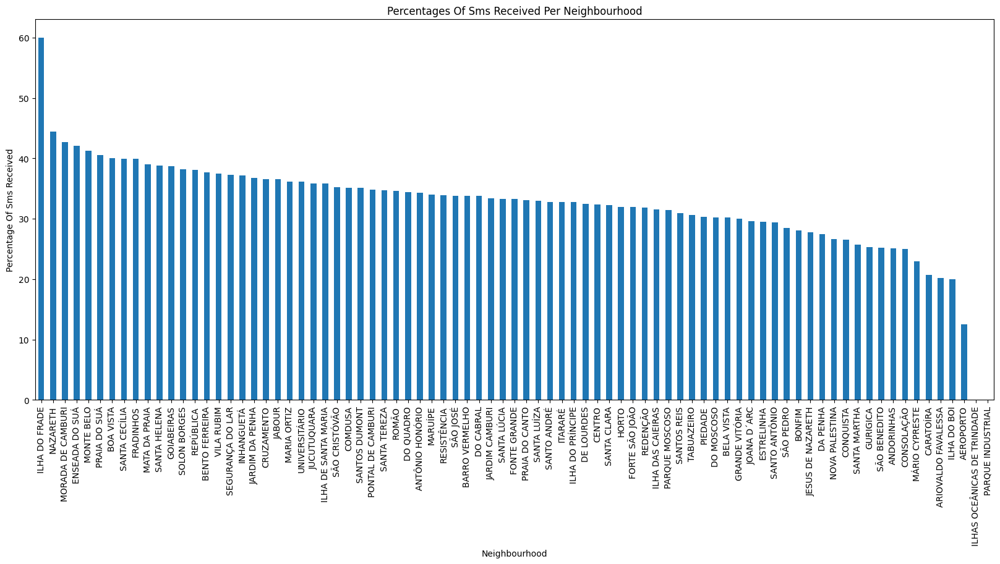

In [80]:
# create subsets
show = df.query('SMS_received == 0')
no_show = df.query('SMS_received == 1')

# Investigating neighbourhoods exlusively in regards to SMS received or not
hoods_no_show = no_show.groupby(['Neighbourhood']).count()['SMS_received']
hoods = df.groupby(['Neighbourhood']).count()['SMS_received']
hoods_show = show.groupby(['Neighbourhood']).count()['SMS_received']

percentages_no_show = hoods_no_show/hoods*100
percentages_no_show.sort_values()

# Plotting percentages of SMS_received per neighbourhood
percentages_no_show.sort_values(ascending=False).plot(kind='bar', title='Percentages of SMS received per Neighbourhood'.title(), figsize=(20,8));
plt.ylabel('Percentage of SMS received'.title().replace("_"," "))
plt.xlabel('neighbourhood'.title());

In [81]:
#What is the size of your dataframe? 
df.size

1547378

In [82]:
#Remove duplocates values
df.drop_duplicates(inplace = True)
print(df.to_string())

           PatientId  AppointmentID Gender          ScheduledDay        AppointmentDay  Age                Neighbourhood  Scholarship  Hipertension  Diabetes  Alcoholism  Handcap  SMS_received No-show
0       2.987250e+13        5642903      F  2016-04-29T18:38:08Z  2016-04-29T00:00:00Z   62              JARDIM DA PENHA            0             1         0           0        0             0      No
1       5.589978e+14        5642503      M  2016-04-29T16:08:27Z  2016-04-29T00:00:00Z   56              JARDIM DA PENHA            0             0         0           0        0             0      No
2       4.262962e+12        5642549      F  2016-04-29T16:19:04Z  2016-04-29T00:00:00Z   62                MATA DA PRAIA            0             0         0           0        0             0      No
3       8.679512e+11        5642828      F  2016-04-29T17:29:31Z  2016-04-29T00:00:00Z    8            PONTAL DE CAMBURI            0             0         0           0        0             0    

In [83]:
#Fixing Wrong Data
for x in df.index:
  if df.loc[x, "Age"] < 1:
    df.loc[x, "Age"] = 1
    
    #print(df.Age.to_string(index=False))

# Research questions 
# Age Ranage 

In [84]:
#Age Ranage 
df['Age'] = df['Age'].astype(str).str.strip('+').astype(int)


In [10]:
#Count Number of F AND M 

gender = df[['Gender','Age']].groupby([ 'Gender']).count()

print(gender)

          Age
Gender       
F       71840
M       38687


In [11]:
# Number of Patient Per Neighbourhood

Neighbourhood_Patient = df[['PatientId','Neighbourhood']].groupby([ 'Neighbourhood']).count()

print(Neighbourhood_Patient)


                     PatientId
Neighbourhood                 
AEROPORTO                    8
ANDORINHAS                2262
ANTÔNIO HONÓRIO            271
ARIOVALDO FAVALESSA        282
BARRO VERMELHO             423
...                        ...
SÃO JOSÉ                  1977
SÃO PEDRO                 2448
TABUAZEIRO                3132
UNIVERSITÁRIO              152
VILA RUBIM                 851

[81 rows x 1 columns]


In [85]:
# Number of Patient They Recived SMS

Recived_SMS = df[['PatientId','SMS_received']].groupby( df['SMS_received'] == 1).count()

print(Recived_SMS)


              PatientId  SMS_received
SMS_received                         
False             75045         75045
True              35482         35482


In [86]:
# Number of Patient They Have Scholarship

Recived_SMS = df[['PatientId','Scholarship']].groupby( df['Scholarship'] == 1).count()

print(Recived_SMS)


             PatientId  Scholarship
Scholarship                        
False            99666        99666
True             10861        10861


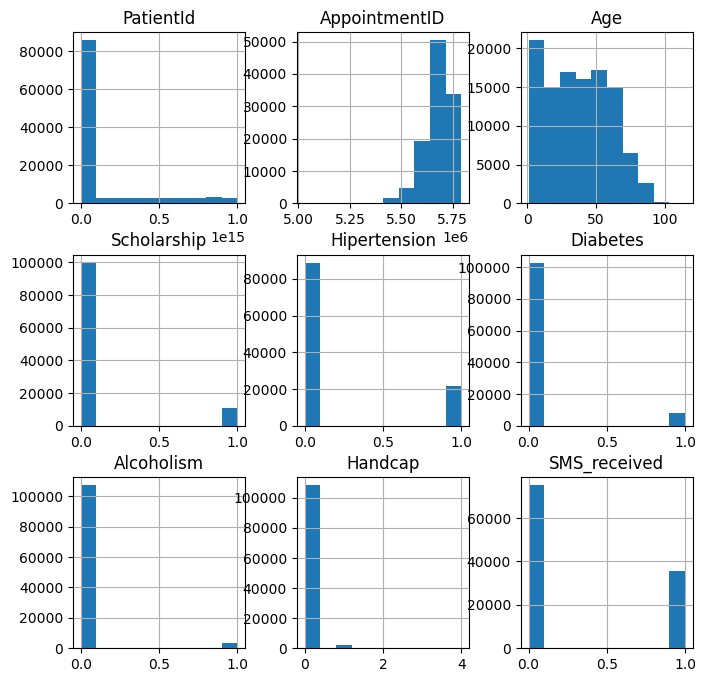

In [87]:
# This will help us to see over all dataset
df.hist(figsize=(8, 8));

This will help us to see Age range that we have in dataset


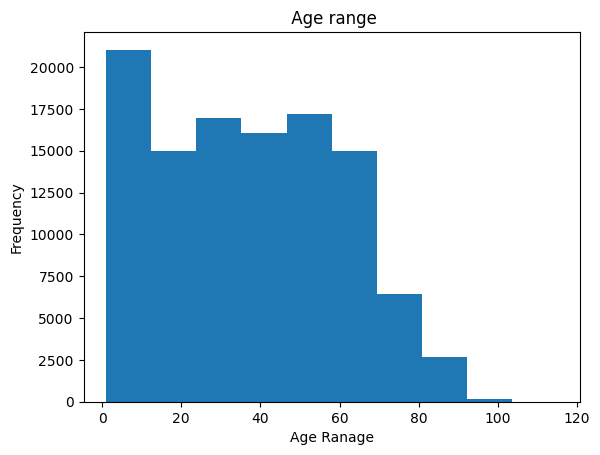

In [90]:
# This will help us to see Age range that we have in dataset
df['Age'].plot(kind='hist');
plt.title(" Age range")
plt.xlabel('Age Ranage'.title());
print("This will help us to see Age range that we have in dataset")

This will help us to see number of Number of hospital vistiors As you can see 80% they come and 20% they did not


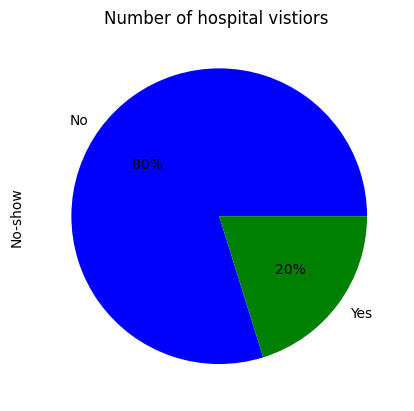

In [91]:
# This will help us to see number of visits And non-visits
df['No-show'].value_counts().plot(kind='pie', y='points', autopct='%1.0f%%',
                                colors = ['blue','green'],
                                title='Number of hospital vistiors ')

print("This will help us to see number of Number of hospital vistiors As you can see 80% they come and 20% they did not")

In [92]:
# This will help us to group Patient beasd on Neighbourhood
df.groupby("Neighbourhood").mean(numeric_only=True)

,PatientId,AppointmentID,Age,Scholarship,Hipertension,Diabetes,Alcoholism,Handcap,SMS_received
Neighbourhood,,,,,,,,,
AEROPORTO,3.945965e+13,5.657990e+06,53.125000,0.000000,0.250000,0.000000,0.000000,0.000000,0.125000
ANDORINHAS,1.495863e+14,5.677587e+06,36.135721,0.142794,0.259063,0.132184,0.022989,0.040230,0.250663
ANTÔNIO HONÓRIO,1.361996e+14,5.668357e+06,36.896679,0.051661,0.018450,0.011070,0.000000,0.003690,0.343173
ARIOVALDO FAVALESSA,1.517085e+14,5.685724e+06,32.897163,0.184397,0.131206,0.067376,0.049645,0.039007,0.202128
BARRO VERMELHO,1.423487e+14,5.686655e+06,45.052009,0.000000,0.134752,0.054374,0.004728,0.014184,0.338061
...,...,...,...,...,...,...,...,...,...
SÃO JOSÉ,1.559789e+14,5.688225e+06,33.668690,0.091047,0.259484,0.120384,0.041477,0.039960,0.338392
SÃO PEDRO,1.389004e+14,5.691532e+06,36.080474,0.131127,0.273693,0.101716,0.061275,0.039624,0.284314
TABUAZEIRO,1.372202e+14,5.678377e+06,35.001596,0.171456,0.227331,0.076628,0.018199,0.027139,0.306194


In [93]:
# This will help us to get the The most common Patient form where 
df["Neighbourhood"].value_counts()

JARDIM CAMBURI                 7717
MARIA ORTIZ                    5805
RESISTÊNCIA                    4431
JARDIM DA PENHA                3877
ITARARÉ                        3514
                               ... 
ILHA DO BOI                      35
ILHA DO FRADE                    10
AEROPORTO                         8
ILHAS OCEÂNICAS DE TRINDADE       2
PARQUE INDUSTRIAL                 1
Name: Neighbourhood, Length: 81, dtype: int64

## conclusions

At the end of this project this these are my conclusions  for it : 

First I cleaned the dataset by **removing** **empty** and **dupliacted** values. 

After that, I started to investigate on data 

The size of the dataframe was **1547378**



And the number of female visitors was **71840**. It represents **65%**

And males were **38687** **35%**

 And most hospital visitors come from **JARDIM CAMBURI** Neighborhood

And the number of patients who received SMS for their appmoveat was **75045** , **35483** was not recvueing 

And the number of patients who have scholarships was **99666**. **10861** did not have scholarships.

## Limitations

1- Data about patients was not enough about the SLA of appointment, which is important in my view 

2- Also they did't show the last visit of a patient 

3- They also need to check if the patient  will come or not , by calling them , not by sending SMS 



<class 'pandas.errors.UndefinedVariableError'>: name 'No_show' is not defined